#  User Engagement Analysis

> Tracking the user’s engagement using the following engagement metrics
- sessions frequency 
- the duration of the session 
- the sessions total traffic (download and upload (bytes))


In [1]:
# importing libraries used to data representation and 
import pandas as pd
import numpy as np
from IPython.display import Image
import matplotlib.pyplot as plt


import warnings
warnings.filterwarnings('ignore')

In [2]:
from kneed import KneeLocator
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

In [3]:
import sys
 
# adding scripts folder to the system path
sys.path.insert(0, '../scripts/')

In [4]:
import PlotUtils as pu
import DataUtils as du

In [5]:
# read the dataset
db = pd.read_csv('../data/cleaned_telcom_data_final.csv')
db.head()

,Bearer Id,Start,Start ms,End,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Last Location Name,...,Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes)
0,"13,114,483,460,844,900,352.00",4/4/2019 12:01,770.00,4/25/2019 14:35,662.00,"1,823,652.00","208,201,448,079,117.00","33,664,962,239.00","35,521,209,507,511.00",9.16456699548519E+015,...,"15,854,611.00","2,501,332.00","8,198,936.00","9,656,251.00","278,082,303.00","14,344,150.00","171,744,450.00","8,814,393.00","36,749,741.00","308,879,636.00"
1,"13,114,483,482,878,900,224.00",4/9/2019 13:04,235.00,4/25/2019 8:15,606.00,"1,365,104.00","208,201,909,211,140.00","33,681,854,413.00","35,794,009,006,359.00",L77566A,...,"20,247,395.00","19,111,729.00","18,338,413.00","17,227,132.00","608,750,074.00","1,170,709.00","526,904,238.00","15,055,145.00","53,800,391.00","653,384,965.00"
2,"13,114,483,484,080,500,736.00",4/9/2019 17:42,1.00,4/25/2019 11:58,652.00,"1,361,762.00","208,200,314,458,056.00","33,760,627,129.00","35,281,510,359,387.00",D42335A,...,"19,725,661.00","14,699,576.00","17,587,794.00","6,163,408.00","229,584,621.00","395,630.00","410,692,588.00","4,215,763.00","27,883,638.00","279,807,335.00"
3,"13,114,483,485,442,799,616.00",4/10/2019 0:31,486.00,4/25/2019 7:36,171.00,"1,321,509.00","208,201,402,342,131.00","33,750,343,200.00","35,356,610,164,913.00",T21824A,...,"21,388,122.00","15,146,643.00","13,994,646.00","1,097,942.00","799,538,153.00","10,849,722.00","749,039,933.00","12,797,283.00","43,324,218.00","846,028,530.00"
4,"13,114,483,499,480,700,928.00",4/12/2019 20:10,565.00,4/25/2019 10:40,954.00,"1,089,009.00","208,201,401,415,120.00","33,699,795,932.00","35,407,009,745,539.00",D88865A,...,"15,259,380.00","18,962,873.00","17,124,581.00","415,218.00","527,707,248.00","3,529,801.00","550,709,500.00","13,910,322.00","38,542,814.00","569,138,589.00"


In [6]:
db.columns

Index(['Bearer Id', 'Start', 'Start ms', 'End', 'End ms', 'Dur. (ms)', 'IMSI',
       'MSISDN/Number', 'IMEI', 'Last Location Name', 'Avg RTT DL (ms)',
       'Avg RTT UL (ms)', 'Avg Bearer TP DL (kbps)', 'Avg Bearer TP UL (kbps)',
       'TCP DL Retrans. Vol (Bytes)', 'TCP UL Retrans. Vol (Bytes)',
       'DL TP < 50 Kbps (%)', '50 Kbps < DL TP < 250 Kbps (%)',
       '250 Kbps < DL TP < 1 Mbps (%)', 'DL TP > 1 Mbps (%)',
       'UL TP < 10 Kbps (%)', '10 Kbps < UL TP < 50 Kbps (%)',
       '50 Kbps < UL TP < 300 Kbps (%)', 'UL TP > 300 Kbps (%)',
       'HTTP DL (Bytes)', 'HTTP UL (Bytes)', 'Activity Duration DL (ms)',
       'Activity Duration UL (ms)', 'Dur. (ms).1', 'Handset Manufacturer',
       'Handset Type', 'Nb of sec with 1250B < Vol UL < 6250B',
       'Nb of sec with 31250B < Vol DL < 125000B',
       'Nb of sec with 6250B < Vol DL < 31250B',
       'Nb of sec with Vol DL < 6250B', 'Nb of sec with Vol UL < 1250B',
       'Social Media DL (Bytes)', 'Social Media UL (Bytes)'

### Aggregate the metrics per customer id (MSISDN/Number)

- sessions frequency 
- the duration of the session 
- the sessions total traffic (download and upload (bytes))


> also extracted the following metrics in order to derive the top 10 most engaged users per application 
- social_total', 'google_total', 'email_total', 'youtube_total', 'netflix_total', 'gaming_total',
             'other_total', 'total_dl_and_ul_data

In [7]:
agg_data = pd.DataFrame()

In [8]:

agg_data['MSISDN'] = db.groupby('MSISDN/Number').groups.keys()

agg_data['session_frequency'] = pd.DataFrame(db.groupby('MSISDN/Number')['IMSI']
     .agg(session_frequency = 'count')).reset_index()['session_frequency']


agg_data['session_duration'] = pd.DataFrame(db.groupby('MSISDN/Number')['Dur. (ms)']
     .agg(session_duration = 'sum')).reset_index()['session_duration']



agg_data['total_ul_data'] = pd.DataFrame(db.groupby('MSISDN/Number')['Total UL (Bytes)']
     .agg(total_ul_data = 'sum')).reset_index()['total_ul_data'] 
agg_data['total_dl_data'] = pd.DataFrame(db.groupby('MSISDN/Number')['Total DL (Bytes)']
             .agg(total_dl_data = 'sum')).reset_index()['total_dl_data']

agg_data['total_dl_and_ul_data'] = agg_data[['total_dl_data','total_ul_data']].sum(axis=1)


agg_data = agg_data.drop(columns=['total_dl_data', 'total_ul_data'])

agg_data.head()

,MSISDN,session_frequency,session_duration,total_dl_and_ul_data
0,"33,601,001,722.00",1,"116,720.00","878,690,574.00"
1,"33,601,001,754.00",1,"181,230.00","156,859,643.00"
2,"33,601,002,511.00",1,"134,969.00","595,966,483.00"
3,"33,601,007,832.00",1,"49,878.00","422,320,698.00"
4,"33,601,008,617.00",1,"18,549.00","585,578,364.00"


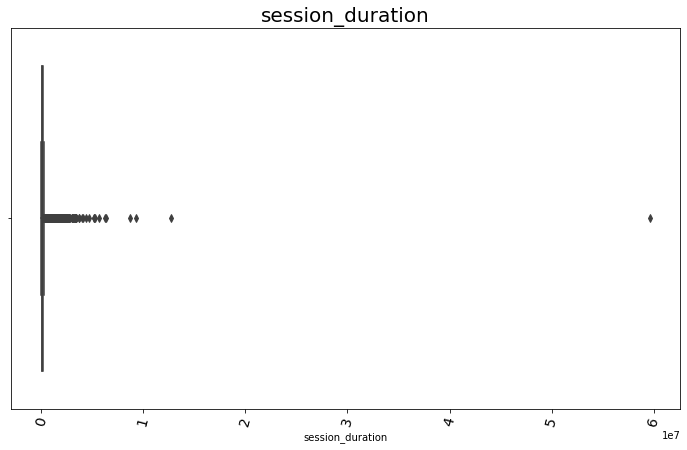

In [9]:
pu.plot_box(agg_data, "session_duration", "session_duration")

In [10]:
agg_data = du.remove_outlier(agg_data, 'session_duration')
agg_data.head()

Old Shape:  (92720, 4)
New Shape:  (85866, 4)


,MSISDN,session_frequency,session_duration,total_dl_and_ul_data
0,"33,601,001,722.00",1,"116,720.00","878,690,574.00"
1,"33,601,001,754.00",1,"181,230.00","156,859,643.00"
2,"33,601,002,511.00",1,"134,969.00","595,966,483.00"
3,"33,601,007,832.00",1,"49,878.00","422,320,698.00"
4,"33,601,008,617.00",1,"18,549.00","585,578,364.00"


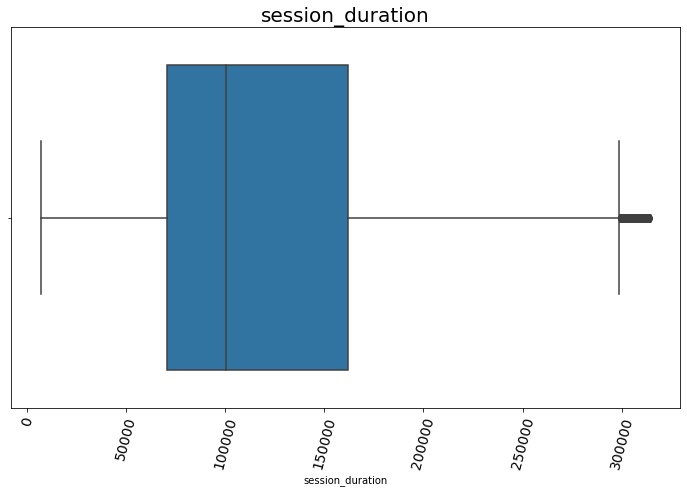

In [11]:
pu.plot_box(agg_data, "session_duration", "session_duration")

In [12]:
# Sorting the DataFrame in descending Order of session_frequency, session_duration, total_dl_and_ul_data
freq_data = agg_data.sort_values(by =['session_frequency'], ascending=False)
dur_data = agg_data.sort_values(by =['session_duration'], ascending=False)
total_data = agg_data.sort_values(by =['total_dl_and_ul_data'], ascending=False)


In [13]:
top10_by_freq = freq_data.head(10)
top10_by_dur = dur_data.head(10)
top10_by_tot = total_data.head(10)

<AxesSubplot:ylabel='Frequency'>

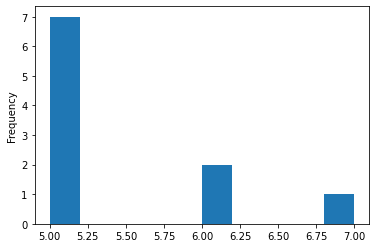

In [14]:
top10_by_freq['session_frequency'].plot(kind="hist")

<AxesSubplot:ylabel='Frequency'>

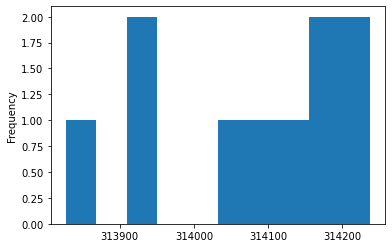

In [15]:
top10_by_dur['session_duration'].plot(kind="hist")

<AxesSubplot:ylabel='Frequency'>

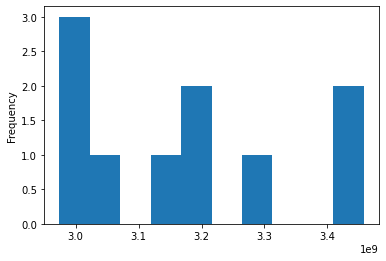

In [16]:
top10_by_tot['total_dl_and_ul_data'].plot(kind="hist")

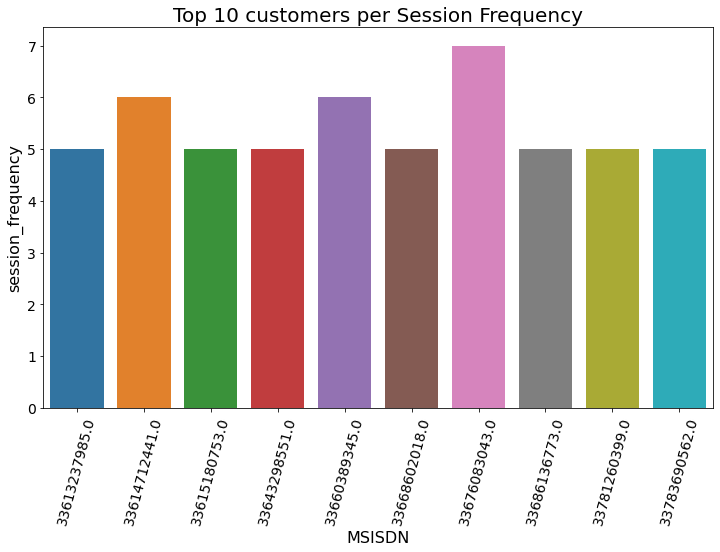

In [17]:
pu.plot_bar(top10_by_freq,  'MSISDN','session_frequency','Top 10 customers per Session Frequency', 'MSISDN','session_frequency' )

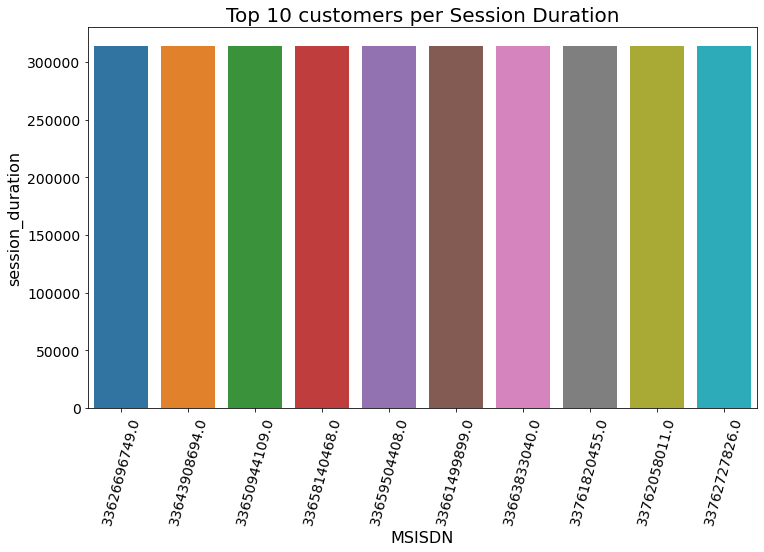

In [18]:
pu.plot_bar(top10_by_dur,  'MSISDN','session_duration','Top 10 customers per Session Duration', 'MSISDN','session_duration' )

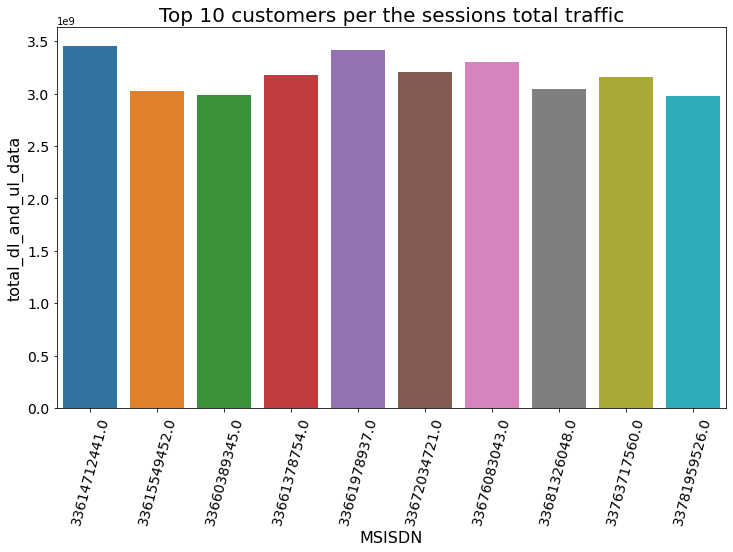

In [19]:
pu.plot_bar(top10_by_tot,  'MSISDN','total_dl_and_ul_data','Top 10 customers per the sessions total traffic', 'MSISDN','total_dl_and_ul_data' )

###  classify customers in three groups of engagement

In [20]:
# scale / Normalize each engagement metric
x = agg_data.iloc[:,[1,2,3]].values

scaler = StandardScaler()
scaled_features = scaler.fit_transform(x)
scaled_data = pd.DataFrame()
scaled_data['session_frequency'] = scaled_features[:][:,0]
scaled_data['session_duration'] = scaled_features[:][:,1]
scaled_data['total_dl_and_ul_data'] = scaled_features[:][:,2]
scaled_data.head()

,session_frequency,session_duration,total_dl_and_ul_data
0,-0.45,0.00,0.78
1,-0.45,0.95,-1.25
2,-0.45,0.27,-0.02
3,-0.45,-0.98,-0.50
4,-0.45,-1.44,-0.05


In [21]:
scaled_features.shape

(85866, 3)

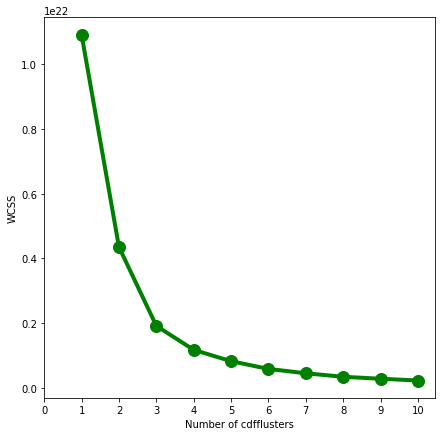

In [22]:

WCSS = []
for i in range(1,11):
    model = KMeans(n_clusters = i,init = 'k-means++')
    model.fit(x)
    WCSS.append(model.inertia_)
fig = plt.figure(figsize = (7,7))
plt.plot(range(1,11), WCSS, linewidth=4, markersize=12,marker='o',color = 'green')
plt.xticks(np.arange(11))
plt.xlabel("Number of cdfflusters")
plt.ylabel("WCSS")
plt.show()

In [23]:
kmeans = KMeans(
       init = "k-means++",
       n_clusters=3,
       n_init=10,
       max_iter=300,
       random_state=0 )

In [24]:
label = kmeans.fit(scaled_features)

In [25]:
# The lowest SSE value - which is the euclidean distance of each point to its closest centroid.
kmeans.inertia_

101317.61309330289

In [26]:
# Final locations of the centroid
kmeans.cluster_centers_

array([[-0.42914521,  0.76268348, -0.30377377],
       [ 1.96363166,  0.87884429,  1.3835957 ],
       [-0.4195277 , -0.71378734, -0.29483591]])

In [27]:
# The number of iterations required to converge
kmeans.n_iter_

14

In [28]:
# add the labels to Dataframe
scaled_data['label'] = kmeans.labels_
scaled_data.head(10)


,session_frequency,session_duration,total_dl_and_ul_data,label
0,-0.45,0.00,0.78,2
1,-0.45,0.95,-1.25,0
2,-0.45,0.27,-0.02,0
3,-0.45,-0.98,-0.50,2
4,-0.45,-1.44,-0.05,2
5,-0.45,0.13,-0.51,0
6,1.66,0.17,0.15,1
7,-0.45,0.12,0.37,0
8,-0.45,1.93,-1.37,0
9,-0.45,-0.28,-0.34,2


In [29]:
scaled_data[scaled_data['label'] == 1]

,session_frequency,session_duration,total_dl_and_ul_data,label
6,1.66,0.17,0.15,1
18,1.66,1.61,1.46,1
25,3.78,0.67,3.75,1
27,1.66,0.32,-0.53,1
29,1.66,1.30,-0.39,1
...,...,...,...,...
85839,1.66,2.00,1.40,1
85847,1.66,1.06,0.31,1
85848,1.66,-0.90,1.71,1
85859,1.66,1.35,2.63,1


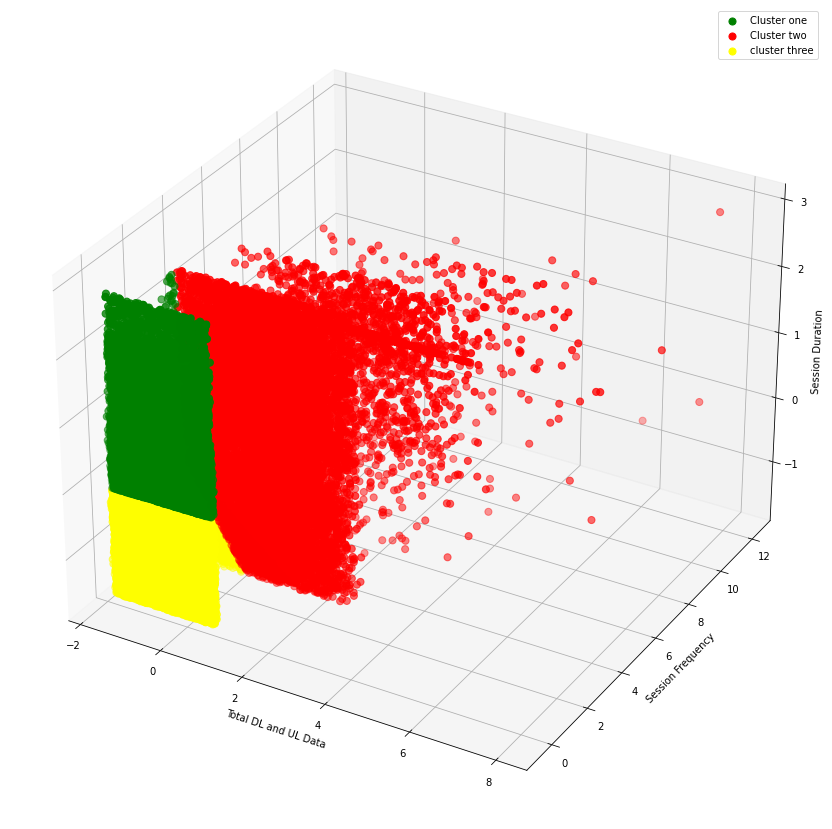

In [31]:
fig = plt.figure(figsize = (15,15))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(
           scaled_data[scaled_data['label'] == 0]["total_dl_and_ul_data"],
           scaled_data[scaled_data['label'] == 0]["session_frequency"],
           scaled_data[scaled_data['label'] == 0]["session_duration"]
           ,s = 50, c = 'green', label = "Cluster one")

ax.scatter(
           scaled_data[scaled_data['label'] == 1]["total_dl_and_ul_data"],
           scaled_data[scaled_data['label'] == 1]["session_frequency"],
           scaled_data[scaled_data['label'] == 1]["session_duration"]
           ,s = 50, c = 'red', label = "Cluster two")

ax.scatter(
           scaled_data[scaled_data['label'] == 2]["total_dl_and_ul_data"],
           scaled_data[scaled_data['label'] == 2]["session_frequency"],
           scaled_data[scaled_data['label'] == 2]["session_duration"]
           ,s = 50, c = 'yellow', label = "cluster three")

# ax.scatter(kmeans.cluster_centers_[:,0],kmeans.cluster_centers_[:,1], s = 100, c = "yellow", label = "centroids")
ax.set_xlabel("Total DL and UL Data")
ax.set_ylabel("Session Frequency")
ax.set_zlabel("Session Duration")
ax.legend()
plt.show()

In [32]:
import plotly.graph_objs as go
from plotly import tools
from plotly.subplots import make_subplots
import plotly.offline as py

In [38]:
# 3d scatterplot using plotly
Scene = dict(xaxis = dict(title  = 'total_dl_and_ul_data -->'),yaxis = dict(title  = 'session_frequency--->'),zaxis = dict(title  = 'session_duration-->'))

# model.labels_ is nothing but the predicted clusters i.e y_clusters
labels = kmeans.labels_
trace = go.Scatter3d(x = scaled_data["total_dl_and_ul_data"],
                   y = scaled_data["session_frequency"],
                   z = scaled_data["session_duration"], mode='markers',marker=dict(color = labels, size= 10, line=dict(color= 'black',width = 10)))
layout = go.Layout(margin=dict(l=0,r=0),scene = Scene,height = 800,width = 800)
data = [trace]
fig = go.Figure(data = data, layout = layout)
fig.show()

In [39]:
agg_data['label'] = kmeans.labels_
agg_data.head(10)

,MSISDN,session_frequency,session_duration,total_dl_and_ul_data,label
0,"33,601,001,722.00",1,"116,720.00","878,690,574.00",2
1,"33,601,001,754.00",1,"181,230.00","156,859,643.00",0
2,"33,601,002,511.00",1,"134,969.00","595,966,483.00",0
3,"33,601,007,832.00",1,"49,878.00","422,320,698.00",2
4,"33,601,008,617.00",1,"18,549.00","585,578,364.00",2
5,"33,601,010,682.00",1,"125,895.00","420,849,288.00",0
6,"33,601,011,634.00",2,"128,360.00","654,723,066.00",1
8,"33,601,020,306.00",1,"124,854.00","732,463,761.00",0
9,"33,601,021,045.00",1,"248,424.00","114,976,036.00",0
10,"33,601,022,743.00",1,"97,363.00","482,419,082.00",2


In [50]:
cluster = [dict(agg_data[agg_data['label'] == 0][['session_frequency', 'session_duration', 'total_dl_and_ul_data']].describe()),
      dict(agg_data[agg_data['label'] == 1][['session_frequency', 'session_duration', 'total_dl_and_ul_data']].describe()),
      dict(agg_data[agg_data['label'] == 2][['session_frequency', 'session_duration', 'total_dl_and_ul_data']].describe())]

In [60]:
col = ['session_frequency', 'session_duration', 'total_dl_and_ul_data']
col_name = [['session_frequency Cluster 1', 'session_frequency Cluster 2', 'session_frequency Cluster 3'],
           ['session_duration Cluster 1', 'session_duration Cluster 2', 'session_duration Cluster 3'],
           ['total_dl_and_ul_data Cluster 1', 'total_dl_and_ul_data Cluster 2', 'total_dl_and_ul_data Cluster 3']]

c_data = []

c = 0
for name in col:
    d = pd.DataFrame()
    for i in range(3):
        d[col_name[c][i]] = [cluster[i][name][3], cluster[i][name][7], cluster[i][name][1], 
                        (cluster[i][name][1] * cluster[i][name][0] )]
    c += 1
    c_data.append(d)

In [77]:
# three cluster on Session 
c_data[2][:4]

,total_dl_and_ul_data Cluster 1,total_dl_and_ul_data Cluster 2,total_dl_and_ul_data Cluster 3
0,"33,575,840.00","306,893,363.00","33,249,009.00"
1,"950,760,661.00","3,457,809,957.00","949,292,055.00"
2,"494,135,916.93","1,095,447,622.80","496,702,790.97"
3,"12,373,657,495,929.00","16,671,617,371,339.00","22,652,627,485,127.00"


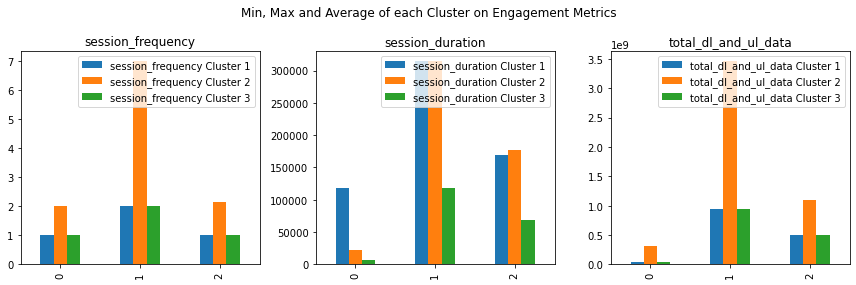

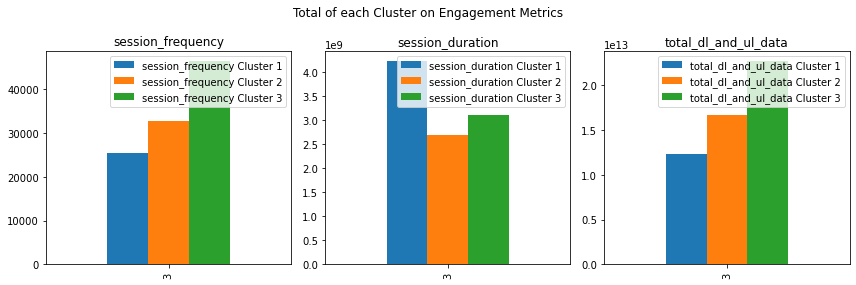

In [84]:
fig, axes = plt.subplots(nrows=1, ncols=3, tight_layout=True)
fig.set_size_inches(12, 4)
fig.suptitle('Min, Max and Average of each Cluster on Engagement Metrics')

counter = 0
for i in range(3):
    c_data[i][:3].plot(ax = axes[counter], kind="bar")
    axes[counter].set_title(col[i])
    
    counter += 1

fig, axes = plt.subplots(nrows=1, ncols=3, tight_layout=True)
fig.set_size_inches(12, 4)
fig.suptitle('Total of each Cluster on Engagement Metrics')

counter = 0
for i in range(3):
    c_data[i][3:].plot(ax = axes[counter], kind="bar")
    axes[counter].set_title(col[i])
    
    counter += 1

### Aggregate user total traffic per application

In [85]:
per_app = pd.DataFrame()

per_app['MSISDN'] = db.groupby('MSISDN/Number').groups.keys()

per_app['session_frequency'] = pd.DataFrame(db.groupby('MSISDN/Number')['IMSI']
     .agg(session_frequency = 'count')).reset_index()['session_frequency']


per_app['session_duration'] = pd.DataFrame(db.groupby('MSISDN/Number')['Dur. (ms)']
     .agg(session_duration = 'sum')).reset_index()['session_duration']


column_names = [('Social Media UL (Bytes)', 'Social Media DL (Bytes)'),
               ('Google DL (Bytes)', 'Google UL (Bytes)'), ('Email DL (Bytes)', 'Email UL (Bytes)'), 
                ('Youtube DL (Bytes)','Youtube UL (Bytes)'), ('Netflix DL (Bytes)', 'Netflix UL (Bytes)'),
               ('Gaming DL (Bytes)', 'Gaming UL (Bytes)'), ('Other DL (Bytes)', 'Other UL (Bytes)'),
               ('Total UL (Bytes)', 'Total DL (Bytes)')]

new_names = [ 'social_total', 'google_total', 'email_total', 'youtube_total', 'netflix_total', 'gaming_total',
             'other_total', 'total_dl_and_ul_data']


for ind in range(len(column_names)):
    
    per_app['total_dl_data'] = pd.DataFrame(db.groupby('MSISDN/Number')[column_names[ind][0]]
         .agg(total_ul_data = 'sum')).reset_index()['total_ul_data'] 
    per_app['total_ul_data'] = pd.DataFrame(db.groupby('MSISDN/Number')[column_names[ind][1]]
                 .agg(total_dl_data = 'sum')).reset_index()['total_dl_data']

    per_app[new_names[ind]] = per_app[['total_dl_data','total_ul_data']].sum(axis=1)


per_app = per_app.drop(columns=['total_dl_data', 'total_ul_data'])

per_app.head()


,MSISDN,session_frequency,session_duration,social_total,google_total,email_total,youtube_total,netflix_total,gaming_total,other_total,total_dl_and_ul_data
0,"33,601,001,722.00",1,"116,720.00","2,232,135.00","4,389,005.00","1,331,362.00","21,624,548.00","27,180,981.00","812,458,661.00","386,570,872.00","878,690,574.00"
1,"33,601,001,754.00",1,"181,230.00","2,660,565.00","5,334,863.00","3,307,781.00","12,432,223.00","11,221,763.00","119,750,078.00","281,710,071.00","156,859,643.00"
2,"33,601,002,511.00",1,"134,969.00","3,195,623.00","3,443,126.00","3,205,380.00","21,333,570.00","19,353,900.00","538,827,713.00","501,693,672.00","595,966,483.00"
3,"33,601,007,832.00",1,"49,878.00","280,294.00","9,678,493.00","2,284,670.00","6,977,321.00","1,942,092.00","391,126,127.00","35,279,702.00","422,320,698.00"
4,"33,601,008,617.00",1,"18,549.00","1,388,485.00","8,328,981.00","1,891,784.00","21,040,520.00","27,228,614.00","512,232,631.00","718,815,824.00","585,578,364.00"


In [86]:
per_app = du.remove_outlier(per_app, 'total_dl_and_ul_data')

Old Shape:  (92720, 11)
New Shape:  (89031, 11)


## Derive the top 10 most engaged users per application

In [87]:
social = per_app.sort_values(by =['social_total'], ascending=False)
google = per_app.sort_values(by =['google_total'], ascending=False)
email = per_app.sort_values(by =['email_total'], ascending=False)
youtube = per_app.sort_values(by =['youtube_total'], ascending=False)
netflix = per_app.sort_values(by =['netflix_total'], ascending=False)
gaming = per_app.sort_values(by =['gaming_total'], ascending=False)
other = per_app.sort_values(by =['other_total'], ascending=False)

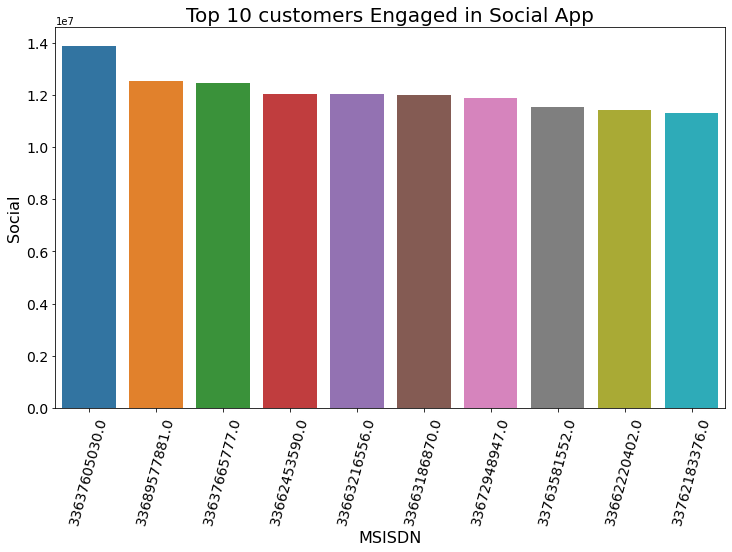

In [88]:
pu.plot_bar_sorted(social.head(10),  'MSISDN','social_total','Top 10 customers Engaged in Social App', 'MSISDN','Social' )

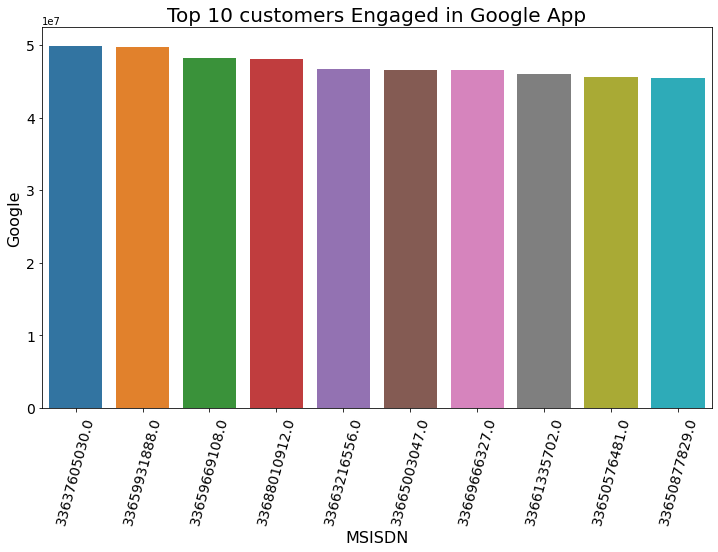

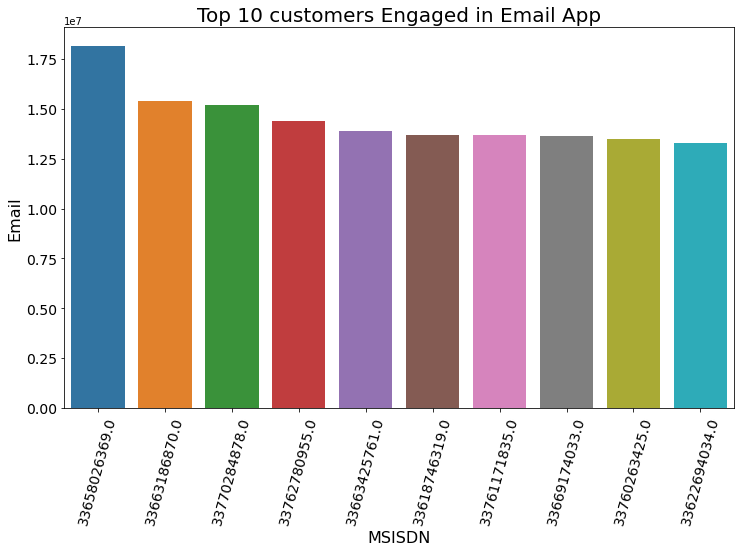

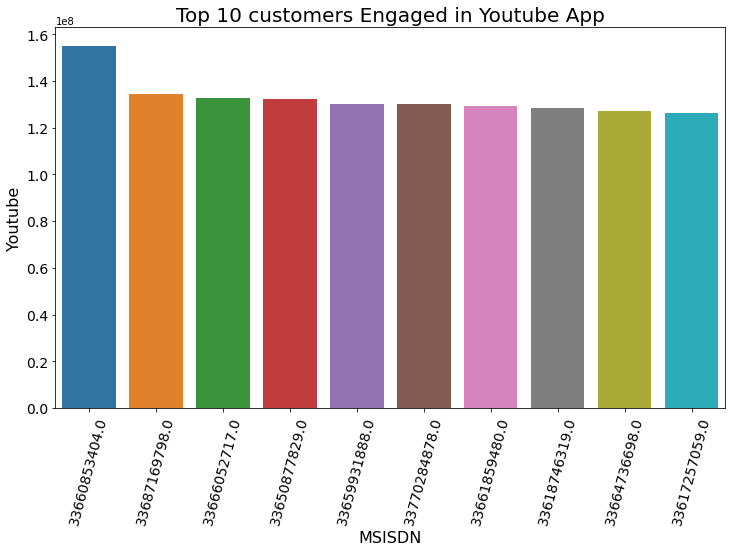

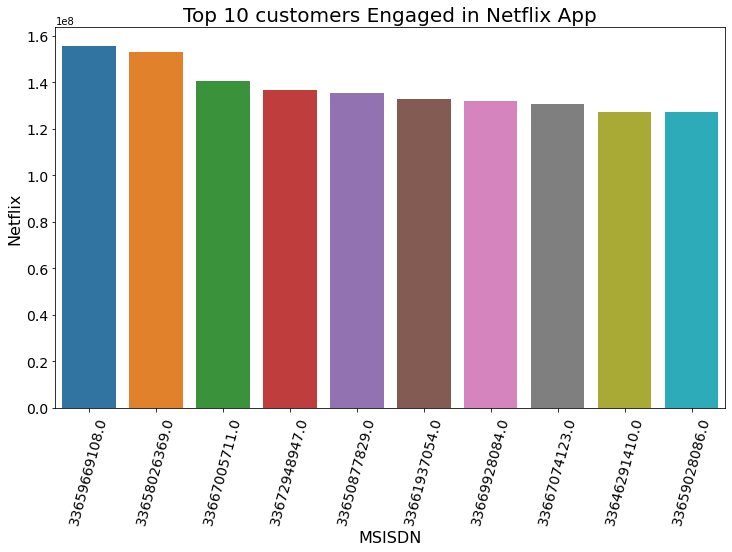

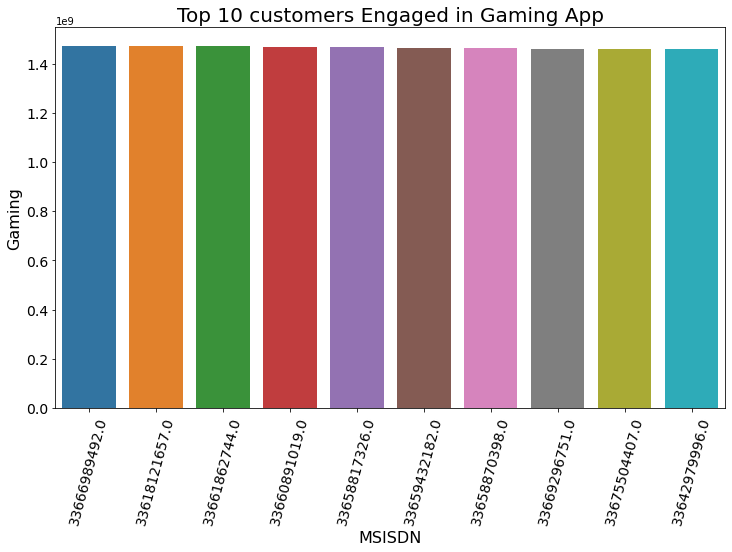

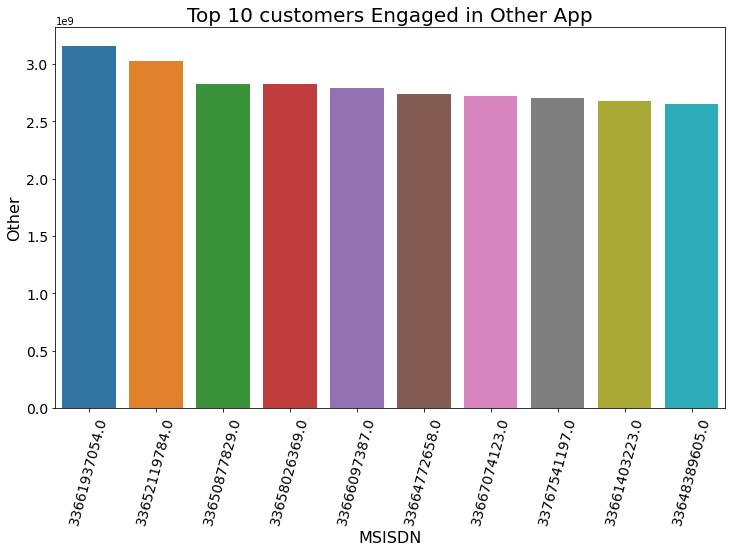

In [89]:
pu.plot_bar_sorted(google.head(10),  'MSISDN','google_total','Top 10 customers Engaged in Google App', 'MSISDN','Google' )
pu.plot_bar_sorted(email.head(10),  'MSISDN','email_total','Top 10 customers Engaged in Email App', 'MSISDN','Email' )
pu.plot_bar_sorted(youtube.head(10),  'MSISDN','youtube_total','Top 10 customers Engaged in Youtube App', 'MSISDN','Youtube' )
pu.plot_bar_sorted(netflix.head(10),  'MSISDN','netflix_total','Top 10 customers Engaged in Netflix App', 'MSISDN','Netflix' )
pu.plot_bar_sorted(gaming.head(10),  'MSISDN','gaming_total','Top 10 customers Engaged in Gaming App', 'MSISDN','Gaming' )
pu.plot_bar_sorted(other.head(10),  'MSISDN','other_total','Top 10 customers Engaged in Other App', 'MSISDN','Other' )

In [90]:
col_names = [ 'social_total', 'google_total', 'email_total', 'youtube_total', 'netflix_total', 'gaming_total',
             'other_total']
app_total = [[name, per_app[name].sum()] for name in col_names ]
app_total

[['social_total', 200240631937.0],
 ['google_total', 853895006685.0],
 ['email_total', 247036580190.0],
 ['youtube_total', 2474790527011.0],
 ['netflix_total', 2471311604664.0],
 ['gaming_total', 45817370109096.0],
 ['other_total', 46960414402631.0]]

In [91]:
apps_engagement = pd.DataFrame(data = app_total, columns=['Application Name', 'Total Engagement'])

apps_engagement.sort_values(by =['Total Engagement'], ascending=False, inplace=True)
apps_engagement.head()

,Application Name,Total Engagement
6,other_total,"46,960,414,402,631.00"
5,gaming_total,"45,817,370,109,096.00"
3,youtube_total,"2,474,790,527,011.00"
4,netflix_total,"2,471,311,604,664.00"
1,google_total,"853,895,006,685.00"


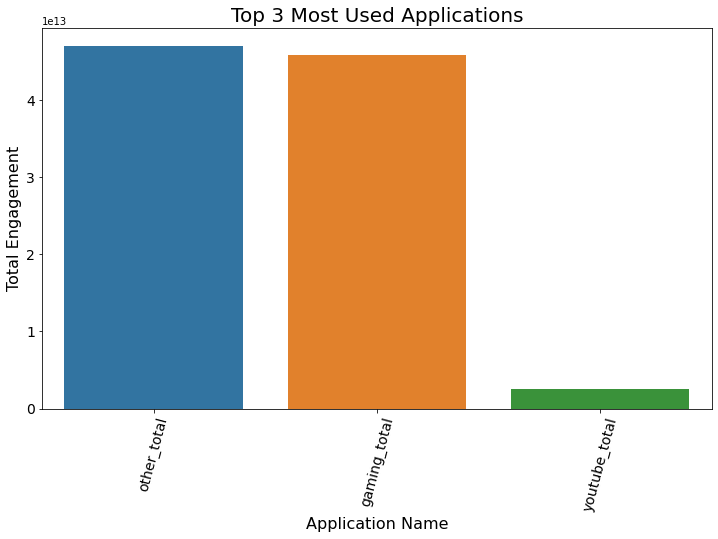

In [92]:
pu.plot_bar_sorted(apps_engagement.head(3),  'Application Name','Total Engagement','Top 3 Most Used Applications', 'Application Name','Total Engagement')

### Group users in k engagement clusters (elbow method)

In [93]:
# scale / Normalize each engagement metric
x = per_app.iloc[:,[1,2,3]].values

scaler = StandardScaler()
scaled_features = scaler.fit_transform(x)
scaled_data = pd.DataFrame()
scaled_data['session_frequency'] = scaled_features[:][:,0]
scaled_data['session_duration'] = scaled_features[:][:,1]
scaled_data['total_dl_and_ul_data'] = scaled_features[:][:,2]
scaled_data.head()

,session_frequency,session_duration,total_dl_and_ul_data
0,-0.47,-0.15,-0.01
1,-0.47,0.44,0.28
2,-0.47,0.02,0.65
3,-0.47,-0.77,-1.36
4,-0.47,-1.06,-0.59


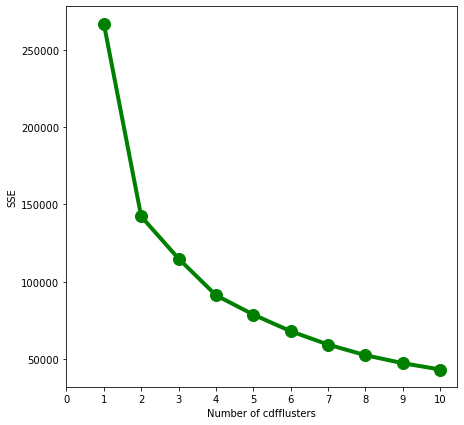

In [94]:
# elbow method

sse = []
for i in range(1,11):
    model = KMeans(n_clusters = i,init = 'k-means++')
    model.fit(scaled_features)
    sse.append(model.inertia_)
fig = plt.figure(figsize = (7,7))
plt.plot(range(1,11), sse, linewidth=4, markersize=12,marker='o',color = 'green')
plt.xticks(np.arange(11))
plt.xlabel("Number of cdfflusters")
plt.ylabel("SSE")
plt.show()

determining the elbow point is hard in this case so we can use Kneed

In [95]:
kl = KneeLocator(range(1, 11), sse, curve="convex", direction="decreasing")

In [96]:
kl.elbow

3

In [97]:
kmeans = KMeans(
       init = "k-means++",
       n_clusters=3,
       n_init=10,
       max_iter=300,
       random_state=0 )

In [98]:
label = kmeans.fit(scaled_features)

In [99]:
scaled_data['label'] = kmeans.labels_
scaled_data.head(10)

,session_frequency,session_duration,total_dl_and_ul_data,label
0,-0.47,-0.15,-0.01,0
1,-0.47,0.44,0.28,0
2,-0.47,0.02,0.65,0
3,-0.47,-0.77,-1.36,1
4,-0.47,-1.06,-0.59,1
5,-0.47,-0.07,0.38,0
6,1.59,-0.04,0.36,2
7,1.59,3.34,2.10,2
8,-0.47,-0.08,-0.89,1
9,-0.47,1.06,-1.19,1


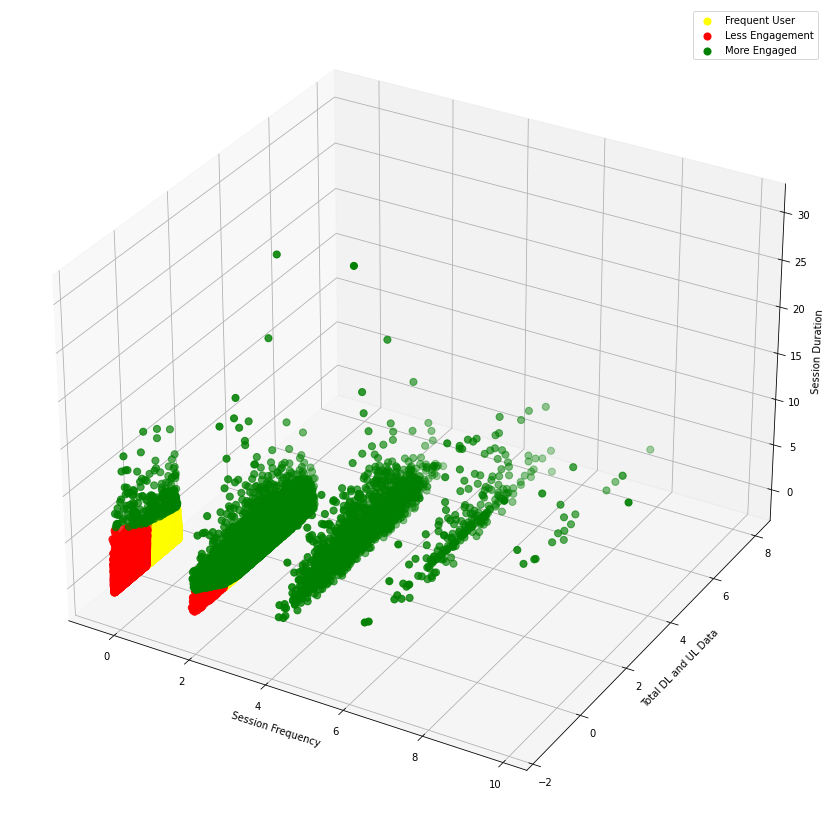

In [113]:
fig = plt.figure(figsize = (15,15))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(
           scaled_data[scaled_data['label'] == 0]["session_frequency"],
           scaled_data[scaled_data['label'] == 0]["total_dl_and_ul_data"],
           scaled_data[scaled_data['label'] == 0]["session_duration"]
           ,s = 50, c = 'yellow', label = "Meduim engagement less")

ax.scatter(
           scaled_data[scaled_data['label'] == 1]["session_frequency"],
           scaled_data[scaled_data['label'] == 1]["total_dl_and_ul_data"],
           scaled_data[scaled_data['label'] == 1]["session_duration"]
           ,s = 50, c = 'red', label = "Less Engagement with less data and Frequency")

ax.scatter(
           scaled_data[scaled_data['label'] == 2]["session_frequency"],
           scaled_data[scaled_data['label'] == 2]["total_dl_and_ul_data"],
           scaled_data[scaled_data['label'] == 2]["session_duration"]
           ,s = 50, c = 'green', label = "More Engaged")

# ax.scatter(kmeans.cluster_centers_[:,0],kmeans.cluster_centers_[:,1], s = 100, c = "yellow", label = "centroids")
ax.set_ylabel("Total DL and UL Data")
ax.set_xlabel("Session Frequency")
ax.set_zlabel("Session Duration")
ax.legend()
plt.show()

In [112]:
# 3d scatterplot using plotly
Scene = dict(zaxis = dict(title  = 'Session Duration--->'),xaxis = dict(title  = 'Total DL and UL Data-->'),yaxis = dict(title  = 'Session Frequency -->'))

# model.labels_ is nothing but the predicted clusters i.e y_clusters
labels = kmeans.labels_
trace = go.Scatter3d(
                   x = scaled_data["total_dl_and_ul_data"],
                   y = scaled_data["session_frequency"],
                   z = scaled_data["session_duration"],
                   mode='markers',marker=dict(color = labels, size= 10, line=dict(color= 'black',width = 10)))
layout = go.Layout(margin=dict(l=0,r=0),scene = Scene,height = 800,width = 800)
data = [trace]
fig = go.Figure(data = data, layout = layout)
fig.show()